<Body>   
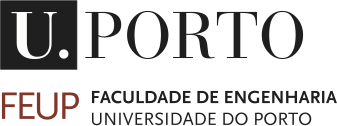   
<h1> <b>Perception and Mapping </b> </h1>
<p><b>Andry Maykol Pinto </b> (amgp@fe.up.pt)</p>
<p><b>Anibal C. Matos </b> (amgp@fe.up.pt)</p>
<p>Department of Electrical and Computer Engineering</p>
</Body>  
FEUP

---

# "Visual Inspection of Offshore Structures"

Unmanned Aerial Vehicles (UAVs) have revolutionized data collection for inspection and mapping, particularly in challenging environments. UAVs are capable of gathering high-resolution imagery, thermal data and LiDAR point clouds, making them valuable assets for surveying and monitoring offshore structures like oil platforms, CALM buoys, wind turbines, and coastal infrastructure.

For this assignment, you will work with a multi-modal dataset collected by a UAV as it inspects a CALM buoy - an offshore structure essential for mooring tankers and transferring oil in open waters. The dataset includes visual, thermal, and LiDAR data, all pre-calibrated and ready to use, offering an authentic setup that reflects real-world challenges faced in offshore inspection.

**Objectives**

To create a dense and accurately textured 3D representation of the CALM buoy, merging thermal and spatial data into a unified model that closely resembles the actual structure. Thermal imaging is essential for inspecting CALM buoys because it enables the detection of temperature anomalies that can indicate structural issues, such as corrosion, leaks or mechanical wear, which might not be visible through standard visual inspections.

1. Data Integration: You will work with a combination of thermal images, and LiDAR point clouds, requiring you to integrate these diverse data types into a cohesive pipeline.

2. Point Cloud Texturization: enhance the point cloud by applying textures derived from the UAV's captured imagery, by aligning 2D images onto the 3D structure without needing to implement blending techniques (keeping the emphasis on alignment within the scope of the course). This will give your 3D model a more realistic appearance. By representing the temperature in the point cloud data, thermal imaging can help identify potential hotspots or areas of heat loss that signify material degradation or damage.

3. Point Cloud Registration: register multiple point clouds from different UAV viewpoints. This involves aligning and merging individual point clouds into a cohesive model, overcoming the spatial variations inherent in data collected from different perspectives.


## Description of the dataset

This assignment use data collected by an Unmanned Aerial Vehicle (UAV) during the inspection routines of a offshore structure in the [ATLANTIS Test Centre](https://www.linkedin.com/company/68810369/). The data retrieved by the UAV includes:

* **Thermographic information**: obtained by a FLIR Boson Radiometric 640x512 resolution camera, with lens distortion model $D_t$ and intrinsic matrix ($K_t$).

* **LiDAR**: is the ouster [OS1-64](https://ouster.com/products/hardware/os1-lidar-sensor) which has 64 channels with a maximum range of 200 metres, a vertical FOV of 45° (± 22.5°) and a precision of ± 0.5 to 3 cm.

* **Visual information**: obtained by a 640x480 resolution camera, with the lens distortion model $D_v$ and intrinsic matrix ($K_v$).

> `Dv: [-0.21292081375160646, 0.1767752984756973, 0.00016650108739115778, -7.265397248140523e-05, -0.05302482500821179]`

> `Kv: [767.942728, 0.0, 339.436073232339, 0.0, 767.068789, 231.644928, 0.0, 0.0, 1.0]`

> `Dt: [-0.504042, 0.26894, 0.003454, -0.000748, 0.0]`

>`Kt: [791.177953960177, 0.0, 317.436073232339, 0.0, 791.2141134510654, 260.3051663940424, 0.0, 0.0, 1.0]`


The extrinsic calibration parameters of this sensor setup is the following:

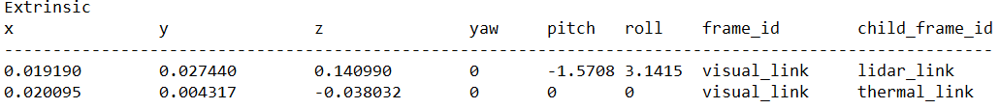

The visual, thermal and point clouds data is timestamped to be possible to select the visual, LiDAR and thermal data with closer timming. This timestamp is encoded directly in the filename of each JPEG or PCD file from the dataset.

* Visual images are named as “image_1693472857**485**557608”
* Point cloud (pcd files) are named as “pointcloud_1693472857**508**994”
* Thermal images are named as “image_1693472857**498**990366




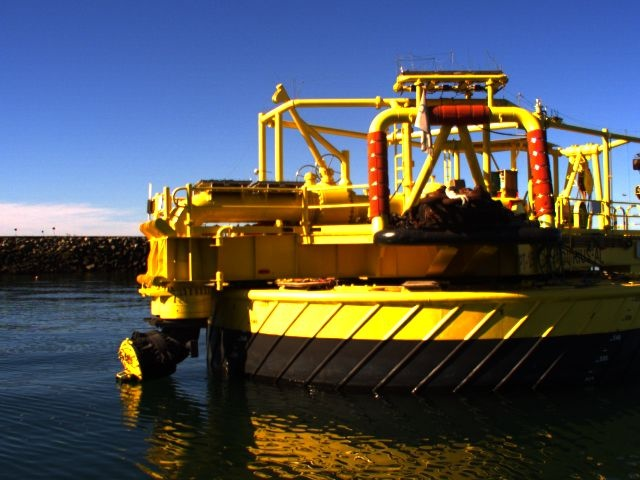

Figure 1 - Visual Images collected by UAV.

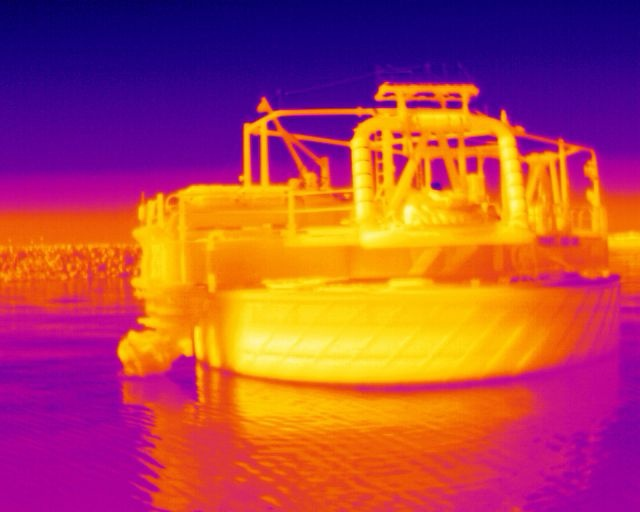

Figure 2 - Thermographic Images collected by UAV.

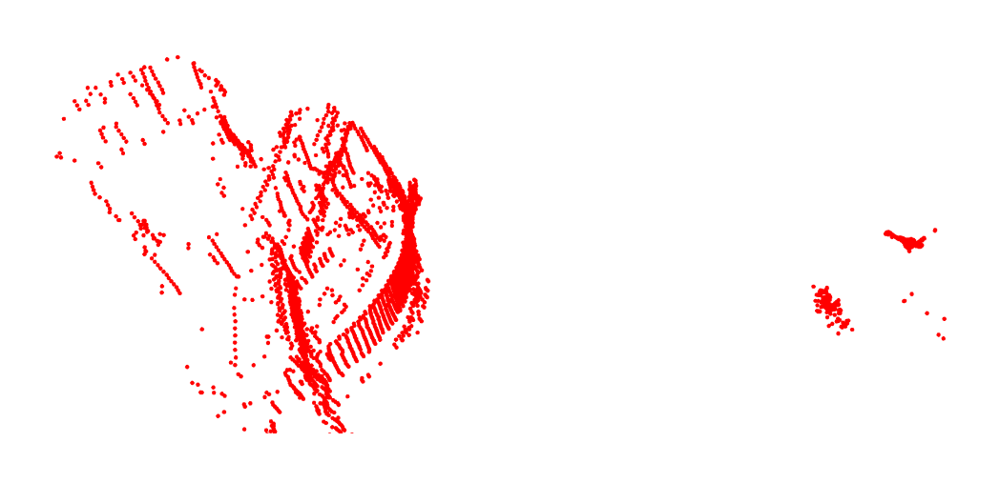

Figure 3 - Point cloud collected by UAV.

## Prepare Libraries and Download dataset

In [75]:
# Install Open3D library
!pip install open3d

In [76]:
# Import libraries
import numpy as np
import open3d as o3d
import copy

# Visualization
import plotly.graph_objects as go  # plotly to visualize since COLAB does not allow to use O3D functions
import matplotlib.pyplot as plt    # or, Matplotlib
from mpl_toolkits import mplot3d

In [77]:
# Visualize point cloud as a scatter plot using matplotlib (as an image!)
def plot_pointcloud_matplotlib_singleview (pt, title_ = ' ', view_ =(-90, 90, 0)):
  colors = None
  if pt.has_colors():
      colors = np.asarray(pt.colors)
  elif pt.has_normals():
      colors = (0.5, 0.5, 0.5) + np.asarray(pt.normals) * 0.5
  else:
      pt.paint_uniform_color((1.0, 0.0, 0.0))
      colors = np.asarray(pt.colors)

  points = np.asarray(pt.points)
  # Single View
  ax = plt.axes(projection='3d')
  ax.view_init(view_[0], view_[1], view_[2])
  ax.axis("on")
  ax.scatter(points[:,0], points[:,1], points[:,2], c=colors)
  ax.set_xlabel('X axis')
  ax.set_ylabel('Y axis')
  ax.set_zlabel('Z axis')

  plt.title(title_)
  plt.show()

#Plotly
def draw_geometries(geometries):
    graph_objects = []

    for geometry in geometries:
        geometry_type = geometry.get_geometry_type()

        if geometry_type == o3d.geometry.Geometry.Type.PointCloud:
            points = np.asarray(geometry.points)
            colors = None
            if geometry.has_colors():
                colors = np.asarray(geometry.colors)
            elif geometry.has_normals():
                colors = (0.5, 0.5, 0.5) + np.asarray(geometry.normals) * 0.5
                geometry.colors = o3d.utility.Vector3dVector(colors)
            else:
                geometry.paint_uniform_color((1.0, 0.0, 0.0))
                colors = np.asarray(geometry.colors)

            scatter_3d = go.Scatter3d(x=points[:,0], y=points[:,1], z=points[:,2], mode='markers', marker=dict(size=2, color=colors))
            graph_objects.append(scatter_3d)

        if geometry_type == o3d.geometry.Geometry.Type.TriangleMesh:
            triangles = np.asarray(geometry.triangles)
            vertices = np.asarray(geometry.vertices)
            colors = None
            if geometry.has_triangle_normals():
                colors = (0.5, 0.5, 0.5) + np.asarray(geometry.triangle_normals) * 0.5
                colors = tuple(map(tuple, colors))
            else:
                colors = (1.0, 0.0, 0.0)

            mesh_3d = go.Mesh3d(x=vertices[:,0], y=vertices[:,1], z=vertices[:,2], i=triangles[:,0], j=triangles[:,1], k=triangles[:,2], facecolor=colors, opacity=0.50)
            graph_objects.append(mesh_3d)

        if geometry_type == o3d.geometry.Geometry.Type.VoxelGrid:
            bounds     = geometry.get_max_bound()-geometry.get_min_bound()

            voxels     = geometry.get_voxels()   # Returns List of Voxel
            vox_mesh   = o3d.geometry.TriangleMesh()

            for v in voxels:
                cube = o3d.geometry.TriangleMesh.create_box(width=1, height=1, depth=1)
                cube.paint_uniform_color(v.color)
                cube.translate(v.grid_index, relative=False)
                vox_mesh += cube

            vox_mesh.translate([0.5,0.5,0.5], relative=True)

            vox_mesh.merge_close_vertices(0.0000001)
            # T=np.array([[1, 0, 0, 0],[0, 0, 1, 0],[0, -1, 0, 0],[0, 0, 0, 1]])
            vox_mesh.translate(geometry.origin, relative=True)

            # Now is like a TriangleMesh
            triangles = np.asarray(vox_mesh.triangles)
            vertices = np.asarray(vox_mesh.vertices)
            colors = None
            if vox_mesh.has_triangle_normals():
                colors = (0.5, 0.5, 0.5) + np.asarray(vox_mesh.triangle_normals) * 0.5
                colors = tuple(map(tuple, colors))
            else:
                vox_mesh.compute_vertex_normals()
                colors = (0.5, 0.5, 0.5) + np.asarray(vox_mesh.triangle_normals) * 0.5
                colors = tuple(map(tuple, colors))                                        # or colors = (0, 0, 0)

            mesh_3d = go.Mesh3d(x=vertices[:,0], y=vertices[:,1], z=vertices[:,2], i=triangles[:,0], j=triangles[:,1], k=triangles[:,2], facecolor=colors, opacity=0.50)
            graph_objects.append(mesh_3d)

    fig = go.Figure(
        data=graph_objects,
        layout=dict(
            scene=dict(
                xaxis=dict(visible=False),
                yaxis=dict(visible=False),
                zaxis=dict(visible=False)
            )
        )
    )
    fig.show()

In [78]:
o3d.visualization.draw_geometries = draw_geometries # replacing the function of Open3D

In [79]:
!wget 'https://uporto-my.sharepoint.com/:u:/g/personal/up488707_up_pt/EU91jtOCygFFgkkekfz2MMUBEbT7RCV-VNYsfDG0Kqm7Lg?download=1' -O DURIUS_d1.zip

--2024-11-28 16:55:33--  https://uporto-my.sharepoint.com/:u:/g/personal/up488707_up_pt/EU91jtOCygFFgkkekfz2MMUBEbT7RCV-VNYsfDG0Kqm7Lg?download=1
Resolving uporto-my.sharepoint.com (uporto-my.sharepoint.com)... 13.107.136.10, 13.107.138.10, 2620:1ec:8f8::10, ...
Connecting to uporto-my.sharepoint.com (uporto-my.sharepoint.com)|13.107.136.10|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /personal/up488707_up_pt/Documents/AULAS/UC_Perception/DataSets/RAVEN/PM_dataset_DURIUS_RAVEN_data_1.zip?ga=1 [following]
--2024-11-28 16:55:33--  https://uporto-my.sharepoint.com/personal/up488707_up_pt/Documents/AULAS/UC_Perception/DataSets/RAVEN/PM_dataset_DURIUS_RAVEN_data_1.zip?ga=1
Reusing existing connection to uporto-my.sharepoint.com:443.
HTTP request sent, awaiting response... 200 OK
Length: 81997028 (78M) [application/x-zip-compressed]
Saving to: ‘DURIUS_d1.zip’

DURIUS_d1.zip       100%[===================>]  78.20M  24.8MB/s    in 3.2s    

2024-11-28 16:55:3

In [80]:
# Extract point clouds from ZIP file.
import zipfile
import os

with zipfile.ZipFile("DURIUS_d1.zip", mode="r") as archive:
  for file in archive.namelist():
    archive.extract(file, "dataset_uav/")

# Exercise 0 - Study and analysis of the sensor setup
Examine the perception system used by this UAV, which includes visual, thermal and LiDAR sensors. You can consult the datasheets of such sensors to support your technical discussion.







## 0.1 - Are there any challenge associated with this perception system?
>**Tip**: discuss the data integration, range, resolution, calibration and environmental factors, among others.

>**Tip**: max 7 sentences.

>**Tip**: provide all sources/references used.



There are several challenges in UAV perception systems.In terms of data integration, having muliple sensors with different sampling rates imposes a fusing challenge to integrate tha data obtained. Related to range and resolution, to have a wide range demands powerful sensors which in UAVs isn't ideal, altitude also plays a crucial parte in precise data aquisition, since LiDAR cannot obtain small or detailed objects if the UAV is flying too high. Calibrating the data obtained is a problem because the vibration and constante motion of UAVs makes it difficult to have a calibration algorithm that works on most data.Depending on the weather and lighting, this type of environmental factors affect both data quality and stability of the UAV, which affects all the aspects talked before.

Sources:UAV-Enabled Integrated Sensing and Communication: Opportunities and Challenges https://ar5iv.labs.arxiv.org/html/2206.03408

Data Augmentation for Environment Perception with Unmanned Aerial Vehicles https://ieeexplore.ieee.org/document/10461075

## 0.2 - Describe the process of calibrating different sensors to achieve accurate registration of the data from each sensor in a common coordinate system. Estimate the uncertainty induced by a 10cm range error in the lidar-to-thermal alignment procedure.

>**Tip**: Consider the minimum range of the LiDAR as 0.5m.

>**Tip**: max 5 sentences.

>**Tip**: provide all sources/references used.



<font color='red'> !!! Complete here!!! </font>

<font color='red'> !!! Complete here!!! </font>

<font color='red'> !!! Complete here!!! </font>

<font color='red'> !!! Complete here!!! </font>

<font color='red'> !!! Complete here!!! </font>


# Exercise 1 - Point Cloud Texturization
Point clouds provide a powerful representation of 3D environments, capturing the spatial structure of objects and scenes with precision. However, raw point clouds lack visual realism as they consist of untextured geometric points. The challenge in this problem is to develop a point cloud texturization process that enhances the visual quality of point cloud data by mapping 2D textures onto 3D surfaces.

>**Problem Overview:**

>Design a function that receives the point cloud and the image, and uses the extrinsic and intrinsic calibration data to obtain the texture information that will be used to colorize the point cloud acquired by the LiDAR.

> **Expected output:** a point cloud with RGB colors in each point. This RGB color must be obtained using the thermal data.






> **From now on, this project is focused only on Thermal and LiDAR data.**

## Loading Images and Point Clouds

Start by selecting a point cloud and a image with similar timestamps.

In [81]:
import open3d as o3d

In [82]:
DIR_PCL = "dataset_uav/data_1/PCD/"
DIR_RGB = "dataset_uav/data_1/RGB/"
DIR_THE = "dataset_uav/data_1/Thermal/"

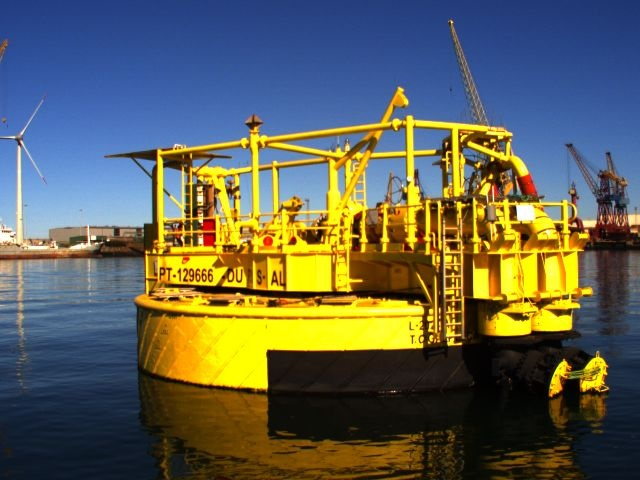

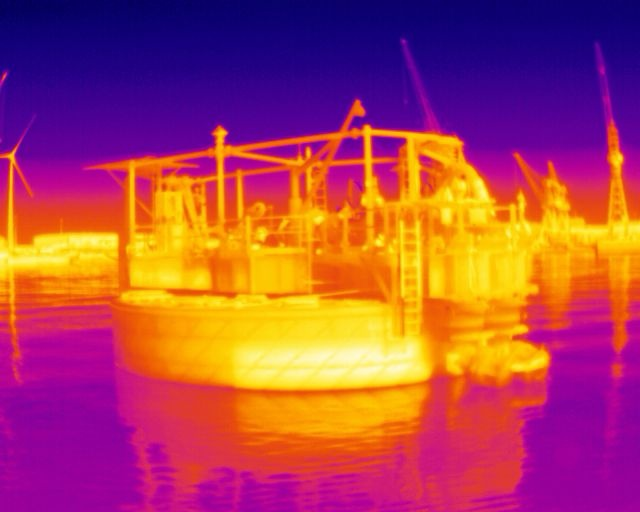

In [83]:
"""
 this example: data is loaded individually. For loading many files --> glob library
"""

import cv2
from google.colab.patches import cv2_imshow
image = cv2.imread(DIR_RGB+"image_1693472857485557608.jpg")
cv2_imshow(image)


image_t = cv2.imread(DIR_THE+"image_1693472857498990366.jpg")
cv2_imshow(image_t)


# Load a PCD file as a point cloud
pt_example = o3d.io.read_point_cloud(DIR_PCL+"pointcloud_1693472857608952.pcd", format='pcd')
if pt_example.is_empty():
  exit()


In [84]:
o3d.visualization.draw_geometries([pt_example])

### 1.1 Pre-processing the point cloud
Apply some pre-processing techniques to improve the quality of the 3D Data.


In [85]:
def preprocessing(pt_cloud):
    x_range = [15,35]
    y_range = [-30,30]
    z_range = [-30,30]

    roi = o3d.geometry.AxisAlignedBoundingBox(min_bound=[x_range[0],y_range[0],z_range[0]],
                                              max_bound=[x_range[1],y_range[1],z_range[1]])
    pt_cloud = pt_cloud.crop(roi)

    return pt_cloud

pt_example_preprocessed = preprocessing(pt_example)
o3d.visualization.draw_geometries([pt_example_preprocessed])


### 1.2 Define the Intrinsic and Extrinsic matrices, and transform the data for different coordinates

Use the Open3D objects/methods to modify the coordinate system of the point cloud.

Transformation matrix from LIDAR to Thermal (H_lt):
[[ 3.67320509e-06 -9.26535897e-05  9.99999996e-01 -9.05000000e-04]
 [-3.40335638e-10 -9.99999996e-01 -9.26535897e-05  2.31230000e-02]
 [ 1.00000000e+00  0.00000000e+00 -3.67320510e-06  1.79022000e-01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]


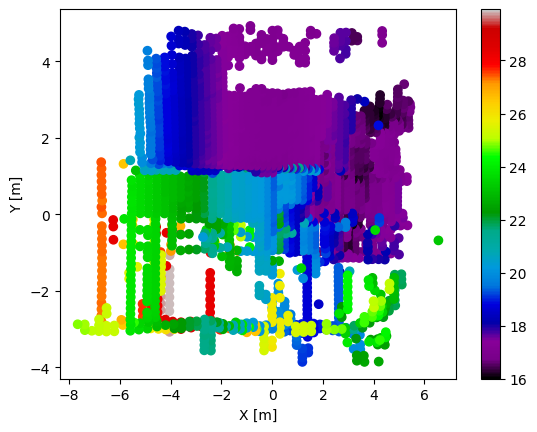

In [86]:
import numpy as np
import open3d as o3d
import matplotlib.pyplot as plt
import copy

# Intrinsic parameters
Dt = [-0.504042, 0.26894, 0.003454, -0.000748, 0.0]
Kt = [791.177953960177, 0.0, 317.436073232339, 0.0, 791.2141134510654, 260.3051663940424, 0.0, 0.0, 1.0]

fx = 791.177953960177
fy = 791.2141134510654
cx = 317.436073232339
cy = 260.3051663940424
width = 640
height = 512

# Camera visual intrinsic matrix
camera_thermal = o3d.camera.PinholeCameraIntrinsic(width, height, fx, fy, cx, cy)

# Transformation matrix: LIDAR -> Visual
H_lv = np.eye(4)
H_lv[:3, 3] = np.array([0.019190, 0.027440, 0.140990])
H_lv[:3, :3] = o3d.geometry.get_rotation_matrix_from_zyx((3.1415, -1.5708, 0))
#H_lv[:3, :3] = o3d.geometry.get_rotation_matrix_from_xyz((3.1415, 1.5708, 3.1415))

# Transformation matrix: Thermal -> Visual
H_tv = np.eye(4)
H_tv[:3, 3] = np.array([0.020095, 0.004317, -0.038032])
H_tv[:3, :3] = o3d.geometry.get_rotation_matrix_from_zyx((0, 0, 0))

# Compute the inverse: Visual -> Thermal
H_vt = np.linalg.inv(H_tv)

# Compute the final transformation: LIDAR -> Thermal
H_lt = H_vt @ H_lv

# Print the transformation matrix
print("Transformation matrix from LIDAR to Thermal (H_lt):")
print(H_lt)

def pt_transform(pt_cloud):

  pt_cloud_transformed = copy.deepcopy(pt_cloud)
  pt_cloud_transformed.transform(H_lt)

  # Get transformed points
  points = np.asarray(pt_cloud_transformed.points)

  # Visualization
  pt_cloud_transformed.points = o3d.utility.Vector3dVector(points)

  return points, pt_cloud_transformed

points, pt_cloud_transformed = pt_transform(pt_example_preprocessed)

# Plot the transformed point cloud
fig, ax = plt.subplots()
sc = ax.scatter(points[:, 0], points[:, 1], c=points[:, 2], cmap="nipy_spectral")
plt.xlabel("X [m]")
plt.ylabel("Y [m]")
plt.colorbar(sc)
plt.show()


### 1.3 Convert 3D Points to Image Plane, and show each 2D point in the RGB image

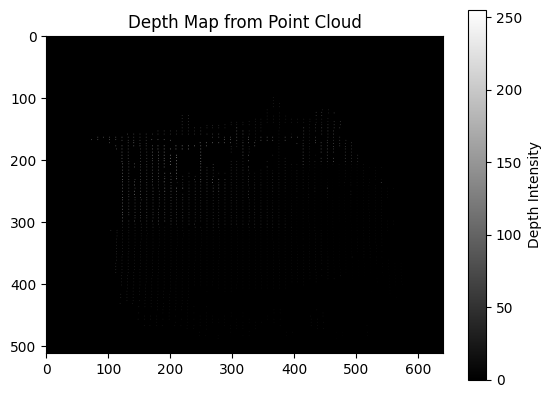

In [87]:
def  project_points_to_image(ptc_cloud, camera):

  # Convert 3D Point to Pixel and Show the point in the RGB image
  pt_cloud = copy.deepcopy(ptc_cloud)
  range_map = np.zeros((camera.height, camera.width), dtype=np.uint8)
  depth_map_pt = []

  points = np.asarray(pt_cloud.points)

  # Define z-range for scaling the depth values
  z_max   = np.max(points[:, 2])
  z_min   = np.min(points[:, 2])
  z_scale = 255.0/(z_max - z_min)

  points_2d = np.dot(camera.intrinsic_matrix, points.T).T
  points_2d[:, 0] /= points_2d[:, 2]
  points_2d[:, 1] /= points_2d[:, 2]

  for i, (point_2d, point_3d) in enumerate(zip(points_2d, points)):

      # Extract pixel coordinates (u, v)
      u = int(point_2d[0])
      v = int(point_2d[1])

      # Check if the projected point is within the image boundaries
      if 0 <= u < camera.width and 0 <= v < camera.height:
          # Scale the depth to be in the range [0, 255]
          depth_value = int((point_3d[2] - z_min) * z_scale)
          range_map[v, u] = depth_value
          depth_map_pt.append((v, u, depth_value))

  return range_map, depth_map_pt, points_2d

# Show the range map as a grayscale image
range_map, depth_map_pt, points_2d = project_points_to_image(pt_cloud_transformed, camera_thermal)

plt.imshow(range_map, cmap='gray')
plt.title("Depth Map from Point Cloud")
plt.colorbar(label="Depth Intensity")
plt.show()

In [88]:
pp_3D_2D_projection = np.array(depth_map_pt)
pt_image_projection = o3d.geometry.PointCloud()
pt_image_projection.points = o3d.utility.Vector3dVector(pp_3D_2D_projection)

# Show the 3D -> 2D projection using OpenCV Color Map
range_map_color = cv2.applyColorMap(cv2.cvtColor(range_map, cv2.COLOR_GRAY2BGR), cv2.COLORMAP_HOT)

In [89]:
def img_undistort(image):
  Dt = [-0.504042, 0.26894, 0.003454, -0.000748, 0.0]

  Kt = np.array(camera_thermal.intrinsic_matrix)
  Dt = np.array(Dt)

  # Undistort the image
  image = cv2.undistort(image, Kt, Dt)

  return image

image_t= img_undistort(image_t)

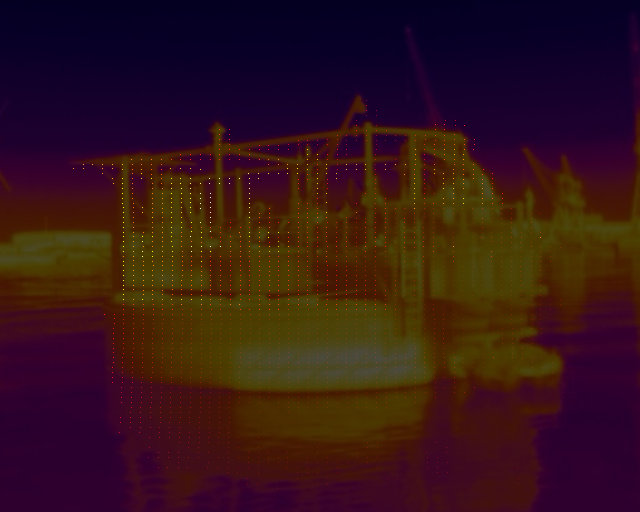

In [90]:
#Showing results (do not change)
image_show = image_t.copy()
image_projection_color = image_show*0.3 + range_map_color*0.9
cv2_imshow(image_projection_color)

### 1.4 Colorize the Point cloud of the DURIUS taking into consideration the RGB data from the Image

In [91]:

def point_cloud_colorization( image, points, points_2d, camera):
  image_show = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

  RBG_pt = []


  for i in range(points.shape[0]):
      # Extract 3D point and corresponding 2D projection
      point_3d = points[i]
      point_2d = points_2d[i]

      # Extract pixel coordinates (u, v)
      u = int(point_2d[0])
      v = int(point_2d[1])

      # Check if the projected point is within the image boundaries
      if 0 <= u < camera_thermal.width and 0 <= v < camera_thermal.height:
          color = image_show[v, u]
          normalized_color = color / 255.0
          RBG_pt.append(normalized_color)
      else:
        RBG_pt.append([0.0, 0.0, 0.0])

  return RBG_pt

pt_image_projection = copy.deepcopy(pt_cloud_transformed)
rgb_image = image_t.copy()
RBG_pt = point_cloud_colorization(rgb_image, points, points_2d, camera_thermal)


In [92]:
#Showing results (do not change)
pt_image_projection.colors = o3d.utility.Vector3dVector(RBG_pt)
o3d.visualization.draw_geometries([pt_image_projection])

### 1.5 Save the final point cloud with texture

In [93]:

o3d.io.write_point_cloud("pc_ex1.ply", pt_image_projection)

True

In [94]:
point_cloud = o3d.io.read_point_cloud("pc_ex1.ply")
o3d.visualization.draw_geometries([point_cloud])
if point_cloud.is_empty():
  exit()

-

-

-

-

-

-

-

-

-----------------------------

# Exercise 2 - Developing a 3D Registration Pipeline

The objective of this task is to design and implement a sophisticated colorized registration pipeline capable of aligning multiple point clouds, each containing corresponding color data, into a unified, high-fidelity 3D model. This system should not only achieve precise geometric alignment but also maintain color consistency across the merged point clouds, resulting in a realistic and information-rich 3D representation.


>**Problem Overview:**

> Develop a robust colorized point cloud registration system that can process multiple input point clouds, each with RGB color information enconding the temperature captured by the thermal camera, and integrate them into a single, coherent 3D model. The system must ensure both high geometric accuracy and color continuity, thereby enhancing the overall visual fidelity and informativeness of the reconstructed model.

> **Expected output:** the unified, colorized point cloud representing the DURIUS infrastructure, where each point is associated with accurate thermal values.

* **50% of penalization:** if *> 75% of all point clouds available* in the dataset are used to create the unified point cloud.

* **25% of penalization:** if *> 25% of all point clouds available* in the dataset are used to create the unified point cloud.

* **0% of penalization:** for implemementations that produce an unified point cloud using *only 10 point clouds retrieved uniformly from all dataset*.





## 2.1 Prepare the dataset that will be used for the registration

a) Select the raw point clouds and corresponding images required for the registration process.

b) Load and apply colorization to each point cloud using the function developed in Part 1 of this assignment.

c) Save each colorized point cloud, ensuring texture information is preserved. Clearly indicate the total number of processed point clouds.

In [102]:
import os
import numpy as np
import open3d as o3d
import cv2

pt_s = []

folder_path = "/content/point_clouds"

if not os.path.exists(folder_path):
    os.makedirs(folder_path)

pcl_files = sorted([f for f in os.listdir(DIR_PCL) if f.endswith('.pcd')])
the_files = sorted([f for f in os.listdir(DIR_THE) if f.endswith('.jpg')])

# Selecionar 10 nuvens de pontos e respetivas imagens RGB
num_pointclouds = 10
indices = np.linspace(0, len(pcl_files) - 1, num_pointclouds, dtype=int)
selected_pcl_files = [pcl_files[i] for i in indices]
selected_the_files = [the_files[i] for i in indices]

for pcl_file, the_file in zip(selected_pcl_files, selected_the_files):

    pt_cloud = o3d.io.read_point_cloud(os.path.join(DIR_PCL, pcl_file))
    pt_cloud_copy = copy.deepcopy(pt_cloud)
    image_t = cv2.imread(os.path.join(DIR_THE, the_file))
    image_t = img_undistort(image_t)

    # Pré-processar a nuvem de pontos
    pt_cloud_preprocessed = preprocessing(pt_cloud_copy)

    # Transformar a nuvem de pontos
    points, pt_cloud_transformed = pt_transform(pt_cloud_preprocessed)

    # Projetar pontos no plano da imagem
    range_map, depth_map_pt, points_2d = project_points_to_image(pt_cloud_transformed, camera_thermal)

    # Colorir a nuvem de pontos
    RBG_pt = point_cloud_colorization(image_t, points, points_2d, camera_thermal)

    # Atualizar cores na nuvem de pontos
    pt_cloud_transformed.colors = o3d.utility.Vector3dVector(RBG_pt)

    # Adicionar a nuvem de pontos processada à lista
    pt_s.append(pt_cloud_transformed)

    # Guardar a nuvem de pontos processada
    output_file_path = os.path.join(folder_path, f"colored_{pcl_file}")
    o3d.io.write_point_cloud(output_file_path, pt_cloud_transformed)

# A lista pt_s contém todas as nuvens de pontos processadas

**Number of point clouds used:**

10



## 2.2 Estimate a transformation matrix for each point cloud

In [96]:
import open3d as o3d
import numpy as np
import os
import copy

# Diretório para salvar as nuvens de pontos alinhadas
aligned_output_path = "/content/point_clouds/aligned"
os.makedirs(aligned_output_path, exist_ok=True)

transformations = [np.eye(4)]  # Primeira nuvem já está no seu referencial
aligned_pt_s = [copy.deepcopy(pt_s[0])]

def global_registration(source, target, voxel_size):
    # Gerar keypoints (downsampling com voxel size)
    source_down = source.voxel_down_sample(voxel_size)
    target_down = target.voxel_down_sample(voxel_size)

    # Calcular Normais
    source_down.estimate_normals(o3d.geometry.KDTreeSearchParamHybrid(radius=voxel_size * 2, max_nn=30))
    target_down.estimate_normals(o3d.geometry.KDTreeSearchParamHybrid(radius=voxel_size * 2, max_nn=30))

    # Extrair descritores FPFH
    source_fpfh = o3d.pipelines.registration.compute_fpfh_feature(
        source_down,
        o3d.geometry.KDTreeSearchParamHybrid(radius=voxel_size * 5, max_nn=100))
    target_fpfh = o3d.pipelines.registration.compute_fpfh_feature(
        target_down,
        o3d.geometry.KDTreeSearchParamHybrid(radius=voxel_size * 5, max_nn=100))

    # Configurar os Correspondence Checkers
    checkers = [
        o3d.pipelines.registration.CorrespondenceCheckerBasedOnEdgeLength(0.9),  # Verifica escala
        o3d.pipelines.registration.CorrespondenceCheckerBasedOnDistance(voxel_size * 1.5)  # Verifica distâncias
    ]

    # Realizar o Global Registration com RANSAC
    result = o3d.pipelines.registration.registration_ransac_based_on_feature_matching(
        source_down, target_down, source_fpfh, target_fpfh,
        mutual_filter=True,  # Sem filtragem mútua de correspondências
        max_correspondence_distance=voxel_size * 1.5,  # Threshold para correspondências
        estimation_method=o3d.pipelines.registration.TransformationEstimationPointToPoint(),
        ransac_n=4,  # Número de pontos para cada iteração do RANSAC
        checkers=checkers,  # Correspondence Checkers
        criteria=o3d.pipelines.registration.RANSACConvergenceCriteria(max_iteration=400000, confidence=0.99)
    )
    return result.transformation  # Retorna a transformação inicial

voxel_size = 0.25  # Ajuste conforme necessário

# Iterar sobre pares consecutivos de nuvens de pontos para alinhamento incremental
for icloud in range(1, len(pt_s)):
    source = pt_s[icloud]  # Nuvem atual a ser alinhada
    target = pt_s[icloud - 1]  # Última nuvem já alinhada como alvo

    # Passo 1: Global Registration para transformação inicial
    initial_transformation = global_registration(source, target, voxel_size)

    # Calcular a distância média dos vizinhos mais próximos para calcular o threshold
    distances = source.compute_nearest_neighbor_distance()
    mean_distance = np.mean(distances)
    threshold = mean_distance * 2  # Ajuste conforme necessário

    print(f"Threshold calculado para nuvem {icloud}: {threshold}")

    # Avaliação inicial (evaluation start)
    evaluation_start = o3d.pipelines.registration.evaluate_registration(
        source=pt_s[icloud],
        target=pt_s[icloud - 1],
        max_correspondence_distance=threshold
    )

    # Passo 2: Refinamento com ICP
    icp = o3d.pipelines.registration.registration_icp(
        source,
        target,
        threshold,  # Usar o threshold calculado dinamicamente
        initial_transformation,  # Transformação inicial
        o3d.pipelines.registration.TransformationEstimationPointToPoint()
    )

    # Criar cópias para avaliação final
    pt_teste_s = copy.deepcopy(pt_s[icloud])
    pt_teste_s.transform(icp.transformation)
    pt_teste_t = copy.deepcopy(pt_s[icloud - 1])

    # Avaliação final (evaluation end)
    evaluation_end = o3d.pipelines.registration.evaluate_registration(
        source=pt_teste_s,
        target=pt_teste_t,
        max_correspondence_distance=threshold
    )

    # Impressão dos resultados
    print("Transformação calculada:")
    print(icp.transformation)
    print("\nInitial guess:")
    print(evaluation_start)
    print("\nAfter ICP:")
    print(evaluation_end)
    print(f"\nICP resultado para nuvem {icloud}:")
    print("Fitness (qualidade):", icp.fitness)
    print("RMSE (erro):", icp.inlier_rmse)

    # Acumular a transformação diretamente para o referencial global
    transformations.append(np.dot(transformations[-1], icp.transformation))

Threshold calculado para nuvem 1: 0.30138250924664534
Transformação calculada:
[[ 9.99998449e-01 -3.12446030e-04  1.73308900e-03 -3.05648050e-02]
 [ 3.13944665e-04  9.99999577e-01 -8.64514484e-04  1.63567004e-02]
 [-1.73281815e-03  8.65057237e-04  9.99998125e-01  2.51824899e-02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Initial guess:
RegistrationResult with fitness=9.341317e-01, inlier_rmse=1.048468e-01, and correspondence_set size of 2184
Access transformation to get result.

After ICP:
RegistrationResult with fitness=9.354149e-01, inlier_rmse=1.022586e-01, and correspondence_set size of 2187
Access transformation to get result.

ICP resultado para nuvem 1:
Fitness (qualidade): 0.935414884516681
RMSE (erro): 0.10225861852205641
Threshold calculado para nuvem 2: 0.2904110993755077
Transformação calculada:
[[ 9.99995882e-01 -2.40926713e-03 -1.55931111e-03  4.71585207e-01]
 [ 2.40727843e-03  9.99996288e-01 -1.27599493e-03 -7.42199497e-02]
 [ 1.56237954e-03  1.

## 2.3 Concatenate the points of all point clouds and create the  unified point cloud.

In [97]:
import open3d as o3d
import numpy as np
import copy

# Certifique-se de que pt_s e transformations estão corretamente definidos
# pt_s: lista de nuvens de pontos
# transformations: lista de transformações acumuladas (mesmo tamanho de pt_s)

if len(transformations) != len(pt_s):
    raise ValueError("O número de transformações não corresponde ao número de nuvens de pontos.")

# Inicializar a lista de nuvens alinhadas com a primeira nuvem
aligned_pt_s = [copy.deepcopy(pt_s[0])]  # Copiar a nuvem inicial

# Iterar sobre as nuvens de pontos e aplicar as transformações acumuladas
for icloud in range(1, len(pt_s)):
    source = pt_s[icloud]  # Nuvem atual
    cloud_copy = copy.deepcopy(source)  # Criar uma cópia para não alterar a original
    cloud_copy.transform(transformations[icloud])  # Aplica a transformação acumulada correta
    aligned_pt_s.append(cloud_copy)  # Adicionar a nuvem alinhada

# Juntar todas as nuvens alinhadas em uma única nuvem de pontos
pt_registered = aligned_pt_s[0]
for cloud in aligned_pt_s[1:]:
    pt_registered += cloud  # Soma cada nuvem alinhada

In [98]:
#Showing results (do not change)
o3d.visualization.draw_geometries([pt_registered])
print(pt_registered)

PointCloud with 21678 points.


## 2.4 Post-processing the registered point cloud

In [99]:
import open3d as o3d
import numpy as np

# --- Filtragem por y < 4 preservando cores ---
print("Filtrando pontos com y >= 4...")
# Converte pontos e cores para NumPy
points = np.asarray(pt_registered.points)
colors = np.asarray(pt_registered.colors)

# Filtra os pontos com y < 4 e mantém as cores correspondentes
mask = points[:, 1] < 3.5
filtered_points = points[mask]
filtered_colors = colors[mask]

# Atualiza a nuvem de pontos e cores filtradas
pt_registered.points = o3d.utility.Vector3dVector(filtered_points)
pt_registered.colors = o3d.utility.Vector3dVector(filtered_colors)
print("Filtragem concluída.")

# Visualizar a nuvem filtrada
o3d.visualization.draw_geometries([pt_registered])

# --- 1. Remoção de Ruídos ---
print("Removendo outliers...")
# Usar filtro estatístico de outliers
pt_clean, ind = pt_registered.remove_statistical_outlier(nb_neighbors=50, std_ratio=3.0)
print("Outliers removidos.")

# Visualizar a nuvem sem ruídos
o3d.visualization.draw_geometries([pt_clean])

# --- 2. Downsampling ---
print("Realizando voxel downsampling...")
voxel_size = 0.001
pt_cloud_registered_filtered = pt_clean.voxel_down_sample(voxel_size)
print("Voxel downsampling concluído.")

# Visualizar a nuvem downsampled
o3d.visualization.draw_geometries([pt_cloud_registered_filtered])

# --- 3. Estimativa de Normais ---
print("Estimando normais...")
pt_cloud_registered_filtered.estimate_normals(
    search_param=o3d.geometry.KDTreeSearchParamHybrid(radius=0.5, max_nn=100)
)
print("Normais estimadas.")

# Visualizar normais estimadas
o3d.visualization.draw_geometries([pt_cloud_registered_filtered])

# --- 4. Reconstrução de Superfície (Poisson) ---
print("Reconstruindo malha usando Poisson...")
mesh, densities = o3d.geometry.TriangleMesh.create_from_point_cloud_poisson(pt_cloud_registered_filtered, depth=15)
print("Malha reconstruída.")

# Remover vértices em áreas de baixa densidade
print("Removendo vértices com baixa densidade...")
densities = np.asarray(densities)
vertices_to_remove = densities < np.quantile(densities, 0.15)  # Ajuste o percentil conforme necessário
mesh.remove_vertices_by_mask(vertices_to_remove)
print("Vértices removidos.")

# Visualizar a malha
o3d.visualization.draw_geometries([mesh])


Filtrando pontos com y >= 4...
Filtragem concluída.


Removendo outliers...
Outliers removidos.


Realizando voxel downsampling...
Voxel downsampling concluído.


Estimando normais...
Normais estimadas.


Reconstruindo malha usando Poisson...
Malha reconstruída.
Removendo vértices com baixa densidade...
Vértices removidos.


In [100]:
#Showing results (do not change)
o3d.visualization.draw_geometries([pt_cloud_registered_filtered])

## 2.5 Save the unified point cloud of DURIUS

In [101]:
## To DO
## To DO
## To DO
## To DO

## 2.6 Comment the results obtained and identify potential improvements

>**Tip**: max 5 sentences.

>**Tip**: provide all sources/references used.

<font color='red'> !!! Complete here!!! </font>

<font color='red'> !!! Complete here!!! </font>

<font color='red'> !!! Complete here!!! </font>

<font color='red'> !!! Complete here!!! </font>

<font color='red'> !!! Complete here!!! </font>

-----------------
-----------------
-----------------


It's DONE!

**Instructions for submitting this work:**
* This colab file must be executed before the delivery.

* The code must be ready to run without permissions for accessing shared folders.

* To avoid problems with the Plotly, please encode an image in this colab (from printscreen) for each core result that you have.

* Deliver also in the Moodle the unified point cloud.
--------------------------

<font color='red'>
Disclaimer for the use of AI tools: complete the text that is placed in between brackets. Convert this disclaimer to PDF, sign it and deliver the PDF in Moodle.
</font>

I, [Student Name], declare that the work presented in this assignment titled "[Assignment Title]" was completed independently, except where explicitly noted. I confirm the following with regard to the use of AI tools:

**Extent of AI Tool Contribution:**

I have used the following AI tool(s) for assistance in this assignment:

1. Tool(s) Used: [List AI tools used, e.g., ChatGPT, Grammarly, QuillBot, etc.]
Nature of Assistance: [Specify the task(s) for which the AI tool was used, e.g., brainstorming ideas, refining language, generating summaries, grammar correction, etc.]
2. Percentage of AI Contribution: [Estimate the percentage of the assignment influenced by the AI tool.]
3. Human Oversight and Contribution:
Despite the use of AI tools, I confirm that the critical thinking, analysis, problem-solving, and final decision-making processes in this assignment were carried out by me. The AI tools were used solely as support for the following purposes: [Elaborate on how the AI tool helped, e.g., improving readability, offering suggestions for structure, or enhancing clarity.]


**Originality and Integrity:**
I take full responsibility for ensuring that the content of this assignment is original and properly cited where applicable. The use of AI tools did not result in any unintentional plagiarism or misrepresentation of ideas from external sources.

**Compliance with Academic Integrity Guidelines:**
I understand the importance of academic integrity, and I confirm that the usage of AI tools complies with the guidelines provided by [School/University Name]. All AI-generated outputs were critically evaluated and appropriately incorporated into the final submission.

Signed,
[Student Name]
[Date]